In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Primero, clonamos el repositorio desde GitHub
!git clone https://github.com/serengil/deepface.git

# Cambiamos el directorio a la carpeta del repositorio
%cd deepface

# Instalamos el paquete de manera editable
!pip install -e .


Cloning into 'deepface'...
remote: Enumerating objects: 7321, done.
remote: Counting objects: 100% (2041/2041), done.
remote: Compressing objects: 100% (549/549), done.
remote: Total 7321 (delta 1661), reused 1595 (delta 1490), pack-reused 5280 (from 1)
Receiving objects: 100% (7321/7321), 53.56 MiB | 51.12 MiB/s, done.
Resolving deltas: 100% (4795/4795), done.
/content/deepface
Obtaining file:///content/deepface
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.2/87.2 kB 3.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.0/85.0 kB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 39.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 62.1 MB/s eta 0:00:00
  Created wheel for fire: filename=fire-0.7.0-py3-none-any.whl size=114249 sha256=1b775f101ed91b0b2a9d9cc544ece03118c304c4fa795788eaea890a4dd587c4
  Stored in directory: /root/.cache/pip/wh

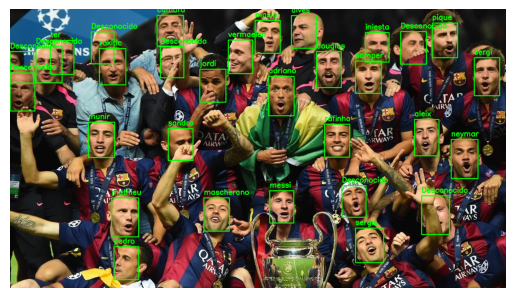

In [ ]:
from deepface import DeepFace
import os
import cv2
from matplotlib import pyplot as plt
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Función para calcular el promedio de embeddings de un jugador
def calculate_average_embedding(img_paths, model_name='Facenet'):
    embeddings = []
    for img_path in img_paths:
        embedding = DeepFace.represent(img_path=img_path, model_name=model_name)[0]['embedding']
        embeddings.append(embedding)
    return np.mean(embeddings, axis=0)

# Cargar la imagen donde se buscarán los jugadores (imagen de grupo)
image_path = "/content/drive/My Drive/BARCELONA/barcelona2.png"
img = cv2.imread(image_path)

# Ruta a la carpeta de convertidas que contiene subcarpetas de jugadores
players_folder = "/content/drive/My Drive/BARCELONA/barcelona/convertidas/"

# Diccionario para almacenar el promedio de embeddings de cada jugador
player_embeddings = {}

# Recorrer todas las subcarpetas (jugadores) en la carpeta convertidas
for player in os.listdir(players_folder):
    player_folder = os.path.join(players_folder, player)
    if os.path.isdir(player_folder):  # Asegurarse de que sea una carpeta
        img_paths = [os.path.join(player_folder, img) for img in os.listdir(player_folder) if img.endswith(('.jpg', '.png'))]
        if img_paths:
            player_avg_embedding = calculate_average_embedding(img_paths)
            player_embeddings[player] = player_avg_embedding

# Detectar los rostros en la imagen de grupo
faces_detected = DeepFace.extract_faces(img_path=image_path, detector_backend='retinaface')

# Conjunto para llevar el registro de los jugadores ya asignados
assigned_players = set()

# Para cada rostro detectado en la imagen de grupo
for face_obj in faces_detected:
    # Extraer las coordenadas del área facial
    x, y, w, h = (face_obj['facial_area']['x'],
                  face_obj['facial_area']['y'],
                  face_obj['facial_area']['w'],
                  face_obj['facial_area']['h'])

    # Recortar el rostro de la imagen original
    face_img = img[y:y+h, x:x+w]

    # Convertir el rostro a RGB si es necesario
    face_img_rgb = cv2.cvtColor(face_img, cv2.COLOR_BGR2RGB)

    # Calcular el embedding del rostro detectado
    face_embedding = DeepFace.represent(img_path=face_img_rgb, model_name='Facenet', enforce_detection=False)[0]['embedding']

    best_similarity = 0
    best_player = None

    # Comparar el embedding del rostro con los embeddings promedios de cada jugador
    for player, player_avg_embedding in player_embeddings.items():
        if player not in assigned_players:  # Solo comparar con jugadores no asignados
            similarity = cosine_similarity([face_embedding], [player_avg_embedding])[0][0]
            if similarity > best_similarity:  # Encontrar la mayor similitud
                best_similarity = similarity
                best_player = player

    # Asignar el nombre del jugador si la similitud es mayor a 0.5
    if best_player and best_similarity > 0.3:
        assigned_players.add(best_player)  # Marcar al jugador como asignado
        player_name = best_player
    else:
        player_name = "Desconocido"

    # Dibujar un rectángulo alrededor del rostro detectado
    cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)

    # Colocar el nombre del jugador sobre el rectángulo
    text_x, text_y = x, y - 10
    font_scale = 0.7
    cv2.putText(img, player_name, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, font_scale, (0, 255, 0), 2)

# Mostrar la imagen con los jugadores identificados
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.show()


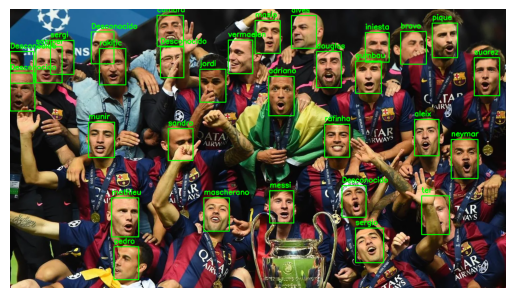

In [ ]:
from deepface import DeepFace
import os
import cv2
from matplotlib import pyplot as plt
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Función para calcular el promedio de embeddings de un jugador
def calculate_average_embedding(img_paths, model_name='Facenet'):
    embeddings = []
    for img_path in img_paths:
        embedding = DeepFace.represent(img_path=img_path, model_name=model_name)[0]['embedding']
        embeddings.append(embedding)
    return np.mean(embeddings, axis=0)

# Cargar la imagen donde se buscarán los jugadores (imagen de grupo)
image_path = "/content/drive/My Drive/BARCELONA/barcelona2.png"
img = cv2.imread(image_path)

# Ruta a la carpeta de convertidas que contiene subcarpetas de jugadores
players_folder = "/content/drive/My Drive/BARCELONA/barcelona/convertidas/"

# Diccionario para almacenar el promedio de embeddings de cada jugador
player_embeddings = {}

# Recorrer todas las subcarpetas (jugadores) en la carpeta convertidas
for player in os.listdir(players_folder):
    player_folder = os.path.join(players_folder, player)
    if os.path.isdir(player_folder):  # Asegurarse de que sea una carpeta
        img_paths = [os.path.join(player_folder, img) for img in os.listdir(player_folder) if img.endswith(('.jpg', '.png'))]
        if img_paths:
            player_avg_embedding = calculate_average_embedding(img_paths)
            player_embeddings[player] = player_avg_embedding

# Detectar los rostros en la imagen de grupo
faces_detected = DeepFace.extract_faces(img_path=image_path, detector_backend='retinaface')

# Conjunto para llevar el registro de los jugadores ya asignados
assigned_players = set()

# Para cada rostro detectado en la imagen de grupo
for face_obj in faces_detected:
    # Extraer las coordenadas del área facial
    x, y, w, h = (face_obj['facial_area']['x'],
                  face_obj['facial_area']['y'],
                  face_obj['facial_area']['w'],
                  face_obj['facial_area']['h'])

    # Recortar el rostro de la imagen original
    face_img = img[y:y+h, x:x+w]

    # Convertir el rostro a RGB si es necesario
    face_img_rgb = cv2.cvtColor(face_img, cv2.COLOR_BGR2RGB)

    # Calcular el embedding del rostro detectado
    face_embedding = DeepFace.represent(img_path=face_img_rgb, model_name='Facenet', enforce_detection=False)[0]['embedding']

    best_similarity = 0
    best_player = None

    # Comparar el embedding del rostro con los embeddings promedios de cada jugador
    for player, player_avg_embedding in player_embeddings.items():
        if player not in assigned_players:  # Solo comparar con jugadores no asignados
            similarity = cosine_similarity([face_embedding], [player_avg_embedding])[0][0]
            if similarity > best_similarity:  # Encontrar la mayor similitud
                best_similarity = similarity
                best_player = player

    # Asignar el nombre del jugador si la similitud es mayor a 0.5
    if best_player and best_similarity > 0.2:
        assigned_players.add(best_player)  # Marcar al jugador como asignado
        player_name = best_player
    else:
        player_name = "Desconocido"

    # Dibujar un rectángulo alrededor del rostro detectado
    cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)

    # Colocar el nombre del jugador sobre el rectángulo
    text_x, text_y = x, y - 10
    font_scale = 0.7
    cv2.putText(img, player_name, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, font_scale, (0, 255, 0), 2)

# Mostrar la imagen con los jugadores identificados
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.show()


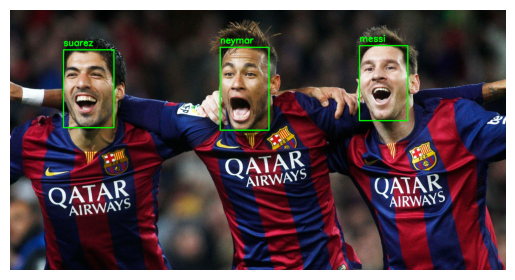

In [ ]:
from deepface import DeepFace
import os
import cv2
from matplotlib import pyplot as plt
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Función para calcular el promedio de embeddings de un jugador
def calculate_average_embedding(img_paths, model_name='Facenet'):
    embeddings = []
    for img_path in img_paths:
        embedding = DeepFace.represent(img_path=img_path, model_name=model_name)[0]['embedding']
        embeddings.append(embedding)
    return np.mean(embeddings, axis=0)

# Cargar la imagen donde se buscarán los jugadores (imagen de grupo)
image_path = "/content/drive/My Drive/BARCELONA/barcelona3.png"
img = cv2.imread(image_path)

# Ruta a la carpeta de convertidas que contiene subcarpetas de jugadores
players_folder = "/content/drive/My Drive/BARCELONA/barcelona/convertidas/"

# Diccionario para almacenar el promedio de embeddings de cada jugador
player_embeddings = {}

# Recorrer todas las subcarpetas (jugadores) en la carpeta convertidas
for player in os.listdir(players_folder):
    player_folder = os.path.join(players_folder, player)
    if os.path.isdir(player_folder):  # Asegurarse de que sea una carpeta
        img_paths = [os.path.join(player_folder, img) for img in os.listdir(player_folder) if img.endswith(('.jpg', '.png'))]
        if img_paths:
            player_avg_embedding = calculate_average_embedding(img_paths)
            player_embeddings[player] = player_avg_embedding

# Detectar los rostros en la imagen de grupo
faces_detected = DeepFace.extract_faces(img_path=image_path, detector_backend='retinaface')

# Conjunto para llevar el registro de los jugadores ya asignados
assigned_players = set()

# Para cada rostro detectado en la imagen de grupo
for face_obj in faces_detected:
    # Extraer las coordenadas del área facial
    x, y, w, h = (face_obj['facial_area']['x'],
                  face_obj['facial_area']['y'],
                  face_obj['facial_area']['w'],
                  face_obj['facial_area']['h'])

    # Recortar el rostro de la imagen original
    face_img = img[y:y+h, x:x+w]

    # Convertir el rostro a RGB si es necesario
    face_img_rgb = cv2.cvtColor(face_img, cv2.COLOR_BGR2RGB)

    # Calcular el embedding del rostro detectado
    face_embedding = DeepFace.represent(img_path=face_img_rgb, model_name='Facenet', enforce_detection=False)[0]['embedding']

    best_similarity = 0
    best_player = None

    # Comparar el embedding del rostro con los embeddings promedios de cada jugador
    for player, player_avg_embedding in player_embeddings.items():
        if player not in assigned_players:  # Solo comparar con jugadores no asignados
            similarity = cosine_similarity([face_embedding], [player_avg_embedding])[0][0]
            if similarity > best_similarity:  # Encontrar la mayor similitud
                best_similarity = similarity
                best_player = player

    # Asignar el nombre del jugador si la similitud es mayor a 0.5
    if best_player and best_similarity > 0.2:
        assigned_players.add(best_player)  # Marcar al jugador como asignado
        player_name = best_player
    else:
        player_name = "Desconocido"

    # Dibujar un rectángulo alrededor del rostro detectado
    cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)

    # Colocar el nombre del jugador sobre el rectángulo
    text_x, text_y = x, y - 10
    font_scale = 0.7
    cv2.putText(img, player_name, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, font_scale, (0, 255, 0), 2)

# Mostrar la imagen con los jugadores identificados
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.show()


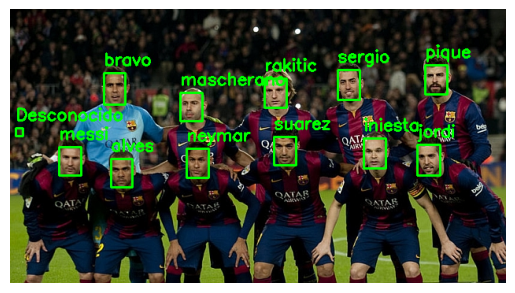

In [ ]:
from deepface import DeepFace
import os
import cv2
from matplotlib import pyplot as plt
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Función para calcular el promedio de embeddings de un jugador
def calculate_average_embedding(img_paths, model_name='Facenet'):
    embeddings = []
    for img_path in img_paths:
        embedding = DeepFace.represent(img_path=img_path, model_name=model_name)[0]['embedding']
        embeddings.append(embedding)
    return np.mean(embeddings, axis=0)

# Cargar la imagen donde se buscarán los jugadores (imagen de grupo)
image_path = "/content/drive/My Drive/BARCELONA/foto.jpg"
img = cv2.imread(image_path)

# Ruta a la carpeta de convertidas que contiene subcarpetas de jugadores
players_folder = "/content/drive/My Drive/BARCELONA/barcelona/convertidas/"

# Diccionario para almacenar el promedio de embeddings de cada jugador
player_embeddings = {}

# Recorrer todas las subcarpetas (jugadores) en la carpeta convertidas
for player in os.listdir(players_folder):
    player_folder = os.path.join(players_folder, player)
    if os.path.isdir(player_folder):  # Asegurarse de que sea una carpeta
        img_paths = [os.path.join(player_folder, img) for img in os.listdir(player_folder) if img.endswith(('.jpg', '.png'))]
        if img_paths:
            player_avg_embedding = calculate_average_embedding(img_paths)
            player_embeddings[player] = player_avg_embedding

# Detectar los rostros en la imagen de grupo
faces_detected = DeepFace.extract_faces(img_path=image_path, detector_backend='retinaface')

# Conjunto para llevar el registro de los jugadores ya asignados
assigned_players = set()

# Para cada rostro detectado en la imagen de grupo
for face_obj in faces_detected:
    # Extraer las coordenadas del área facial
    x, y, w, h = (face_obj['facial_area']['x'],
                  face_obj['facial_area']['y'],
                  face_obj['facial_area']['w'],
                  face_obj['facial_area']['h'])

    # Recortar el rostro de la imagen original
    face_img = img[y:y+h, x:x+w]

    # Convertir el rostro a RGB si es necesario
    face_img_rgb = cv2.cvtColor(face_img, cv2.COLOR_BGR2RGB)

    # Calcular el embedding del rostro detectado
    face_embedding = DeepFace.represent(img_path=face_img_rgb, model_name='Facenet', enforce_detection=False)[0]['embedding']

    best_similarity = 0
    best_player = None

    # Comparar el embedding del rostro con los embeddings promedios de cada jugador
    for player, player_avg_embedding in player_embeddings.items():
        if player not in assigned_players:  # Solo comparar con jugadores no asignados
            similarity = cosine_similarity([face_embedding], [player_avg_embedding])[0][0]
            if similarity > best_similarity:  # Encontrar la mayor similitud
                best_similarity = similarity
                best_player = player

    # Asignar el nombre del jugador si la similitud es mayor a 0.5
    if best_player and best_similarity > 0.4:
        assigned_players.add(best_player)  # Marcar al jugador como asignado
        player_name = best_player
    else:
        player_name = "Desconocido"

    # Dibujar un rectángulo alrededor del rostro detectado
    cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)

    # Colocar el nombre del jugador sobre el rectángulo
    text_x, text_y = x, y - 10
    font_scale = 0.7
    cv2.putText(img, player_name, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, font_scale, (0, 255, 0), 2)

# Mostrar la imagen con los jugadores identificados
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.show()


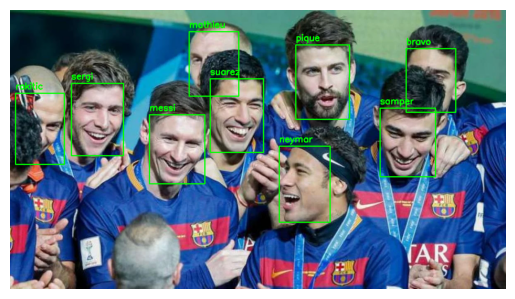

In [ ]:
from deepface import DeepFace
import os
import cv2
from matplotlib import pyplot as plt
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Función para calcular el promedio de embeddings de un jugador
def calculate_average_embedding(img_paths, model_name='Facenet'):
    embeddings = []
    for img_path in img_paths:
        embedding = DeepFace.represent(img_path=img_path, model_name=model_name)[0]['embedding']
        embeddings.append(embedding)
    return np.mean(embeddings, axis=0)

# Cargar la imagen donde se buscarán los jugadores (imagen de grupo)
image_path = "/content/drive/My Drive/BARCELONA/barcelona4.png"
img = cv2.imread(image_path)

# Ruta a la carpeta de convertidas que contiene subcarpetas de jugadores
players_folder = "/content/drive/My Drive/BARCELONA/barcelona/convertidas/"

# Diccionario para almacenar el promedio de embeddings de cada jugador
player_embeddings = {}

# Recorrer todas las subcarpetas (jugadores) en la carpeta convertidas
for player in os.listdir(players_folder):
    player_folder = os.path.join(players_folder, player)
    if os.path.isdir(player_folder):  # Asegurarse de que sea una carpeta
        img_paths = [os.path.join(player_folder, img) for img in os.listdir(player_folder) if img.endswith(('.jpg', '.png'))]
        if img_paths:
            player_avg_embedding = calculate_average_embedding(img_paths)
            player_embeddings[player] = player_avg_embedding

# Detectar los rostros en la imagen de grupo
faces_detected = DeepFace.extract_faces(img_path=image_path, detector_backend='retinaface')

# Conjunto para llevar el registro de los jugadores ya asignados
assigned_players = set()

# Para cada rostro detectado en la imagen de grupo
for face_obj in faces_detected:
    # Extraer las coordenadas del área facial
    x, y, w, h = (face_obj['facial_area']['x'],
                  face_obj['facial_area']['y'],
                  face_obj['facial_area']['w'],
                  face_obj['facial_area']['h'])

    # Recortar el rostro de la imagen original
    face_img = img[y:y+h, x:x+w]

    # Convertir el rostro a RGB si es necesario
    face_img_rgb = cv2.cvtColor(face_img, cv2.COLOR_BGR2RGB)

    # Calcular el embedding del rostro detectado
    face_embedding = DeepFace.represent(img_path=face_img_rgb, model_name='Facenet', enforce_detection=False)[0]['embedding']

    best_similarity = 0
    best_player = None

    # Comparar el embedding del rostro con los embeddings promedios de cada jugador
    for player, player_avg_embedding in player_embeddings.items():
        if player not in assigned_players:  # Solo comparar con jugadores no asignados
            similarity = cosine_similarity([face_embedding], [player_avg_embedding])[0][0]
            if similarity > best_similarity:  # Encontrar la mayor similitud
                best_similarity = similarity
                best_player = player

    # Asignar el nombre del jugador si la similitud es mayor a 0.5
    if best_player and best_similarity > 0.2:
        assigned_players.add(best_player)  # Marcar al jugador como asignado
        player_name = best_player
    else:
        player_name = "Desconocido"

    # Dibujar un rectángulo alrededor del rostro detectado
    cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)

    # Colocar el nombre del jugador sobre el rectángulo
    text_x, text_y = x, y - 10
    font_scale = 0.7
    cv2.putText(img, player_name, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, font_scale, (0, 255, 0), 2)

# Mostrar la imagen con los jugadores identificados
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.show()


In [ ]:
from deepface import DeepFace
import os
import cv2
from matplotlib import pyplot as plt
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Función para calcular el promedio de embeddings de un jugador
def calculate_average_embedding(img_paths, model_name='Facenet'):
    embeddings = []
    for img_path in img_paths:
        embedding = DeepFace.represent(img_path=img_path, model_name=model_name)[0]['embedding']
        embeddings.append(embedding)
    return np.mean(embeddings, axis=0)

# Ruta al video
video_path = "/content/drive/My Drive/BARCELONA/barcelona.mp4"
cap = cv2.VideoCapture(video_path)

# Ruta a la carpeta de convertidas que contiene subcarpetas de jugadores
players_folder = "/content/drive/My Drive/BARCELONA/barcelona/convertidas/"

# Diccionario para almacenar el promedio de embeddings de cada jugador
player_embeddings = {}

# Recorrer todas las subcarpetas (jugadores) en la carpeta convertidas
for player in os.listdir(players_folder):
    player_folder = os.path.join(players_folder, player)
    if os.path.isdir(player_folder):  # Asegurarse de que sea una carpeta
        img_paths = [os.path.join(player_folder, img) for img in os.listdir(player_folder) if img.endswith(('.jpg', '.png'))]
        if img_paths:
            player_avg_embedding = calculate_average_embedding(img_paths)
            player_embeddings[player] = player_avg_embedding

# Variables para promediar embeddings
face_embeddings_per_frame = {}
frame_counter = 0

# Procesar el video frame por frame
while True:
    ret, frame = cap.read()  # Leer el frame del video
    if not ret:
        break  # Si no hay más frames, salir del bucle

    frame_counter += 1

    # Detectar los rostros en el frame
    faces_detected = DeepFace.extract_faces(img_path=frame, detector_backend='retinaface')

    # Para cada rostro detectado en el frame
    for idx, face_obj in enumerate(faces_detected):
        # Extraer las coordenadas del área facial
        x, y, w, h = (face_obj['facial_area']['x'],
                      face_obj['facial_area']['y'],
                      face_obj['facial_area']['w'],
                      face_obj['facial_area']['h'])

        # Recortar el rostro del frame
        face_img = frame[y:y+h, x:x+w]

        # Convertir el rostro a RGB si es necesario
        face_img_rgb = cv2.cvtColor(face_img, cv2.COLOR_BGR2RGB)

        # Calcular el embedding del rostro detectado
        face_embedding = DeepFace.represent(img_path=face_img_rgb, model_name='Facenet', enforce_detection=False)[0]['embedding']

        # Almacenar embeddings por rostro en cada frame
        if idx not in face_embeddings_per_frame:
            face_embeddings_per_frame[idx] = []

        face_embeddings_per_frame[idx].append(face_embedding)

    # Cada 5 frames, promediar los embeddings y comparar con los jugadores
    if frame_counter % 5 == 0:
        assigned_players = set()

        for idx, embeddings in face_embeddings_per_frame.items():
            # Promediar los embeddings acumulados en los últimos 5 frames
            avg_face_embedding = np.mean(embeddings, axis=0)

            best_similarity = 0
            best_player = None

            # Comparar el embedding promedio del rostro con los embeddings promedios de cada jugador
            for player, player_avg_embedding in player_embeddings.items():
                if player not in assigned_players:  # Solo comparar con jugadores no asignados
                    similarity = cosine_similarity([avg_face_embedding], [player_avg_embedding])[0][0]
                    if similarity > best_similarity:  # Encontrar la mayor similitud
                        best_similarity = similarity
                        best_player = player

            # Asignar el nombre del jugador si la similitud es mayor a 0.5
            if best_player and best_similarity > 0.2:
                assigned_players.add(best_player)  # Marcar al jugador como asignado
                player_name = best_player
            else:
                player_name = "Desconocido"

            # Dibujar un rectángulo alrededor del rostro detectado
            x, y, w, h = faces_detected[idx]['facial_area']['x'], faces_detected[idx]['facial_area']['y'], faces_detected[idx]['facial_area']['w'], faces_detected[idx]['facial_area']['h']
            cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)

            # Colocar el nombre del jugador sobre el rectángulo
            text_x, text_y = x, y - 10
            font_scale = 0.7
            cv2.putText(frame, player_name, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, font_scale, (0, 255, 0), 2)

        # Mostrar el frame procesado con los jugadores identificados
        plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        plt.axis("off")
        plt.show()

        # Limpiar los embeddings almacenados para los siguientes 5 frames
        face_embeddings_per_frame = {}

# Liberar recursos
cap.release()
cv2.destroyAllWindows()


IndexError: list index out of range

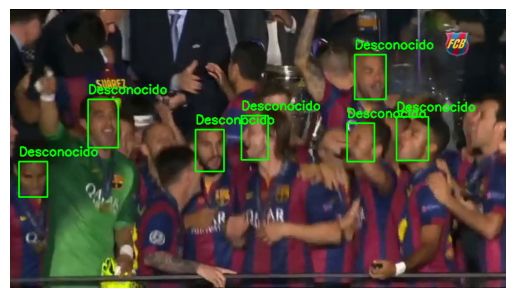

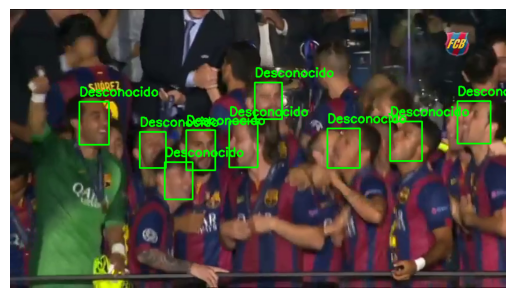

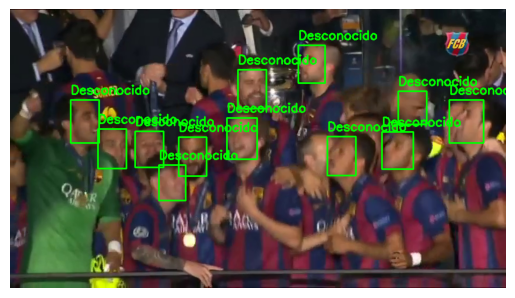

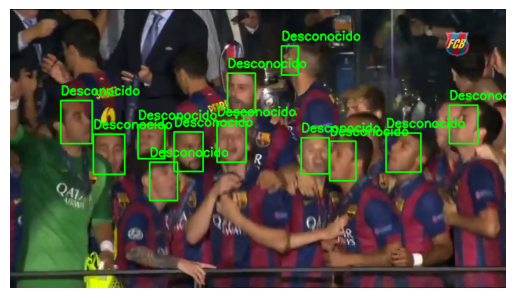

KeyboardInterrupt: 

In [ ]:
from deepface import DeepFace
import os
import cv2
from matplotlib import pyplot as plt
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Función para calcular el promedio de embeddings de un jugador
def calculate_average_embedding(img_paths, model_name='Facenet'):
    embeddings = []
    for img_path in img_paths:
        embedding = DeepFace.represent(img_path=img_path, model_name=model_name)[0]['embedding']
        embeddings.append(embedding)
    return np.mean(embeddings, axis=0)

# Ruta al video
video_path = "/content/drive/My Drive/BARCELONA/barcelona.mp4"
cap = cv2.VideoCapture(video_path)

# Ruta a la carpeta de convertidas que contiene subcarpetas de jugadores
players_folder = "/content/drive/My Drive/BARCELONA/barcelona/convertidas/"

# Diccionario para almacenar el promedio de embeddings de cada jugador
player_embeddings = {}

# Recorrer todas las subcarpetas (jugadores) en la carpeta convertidas
for player in os.listdir(players_folder):
    player_folder = os.path.join(players_folder, player)
    if os.path.isdir(player_folder):  # Asegurarse de que sea una carpeta
        img_paths = [os.path.join(player_folder, img) for img in os.listdir(player_folder) if img.endswith(('.jpg', '.png'))]
        if img_paths:
            player_avg_embedding = calculate_average_embedding(img_paths)
            player_embeddings[player] = player_avg_embedding

# Variables para promediar embeddings
face_embeddings_per_frame = {}
frame_counter = 0

# Procesar el video frame por frame
while True:
    ret, frame = cap.read()  # Leer el frame del video
    if not ret:
        break  # Si no hay más frames, salir del bucle

    frame_counter += 1

    # Detectar los rostros en el frame
    faces_detected = DeepFace.extract_faces(img_path=frame, detector_backend='retinaface')

    # Para cada rostro detectado en el frame
    for idx, face_obj in enumerate(faces_detected):
        # Extraer las coordenadas del área facial
        x, y, w, h = (face_obj['facial_area']['x'],
                      face_obj['facial_area']['y'],
                      face_obj['facial_area']['w'],
                      face_obj['facial_area']['h'])

        # Recortar el rostro del frame
        face_img = frame[y:y+h, x:x+w]

        # Convertir el rostro a RGB si es necesario
        face_img_rgb = cv2.cvtColor(face_img, cv2.COLOR_BGR2RGB)

        # Calcular el embedding del rostro detectado
        face_embedding = DeepFace.represent(img_path=face_img_rgb, model_name='Facenet', enforce_detection=False)[0]['embedding']

        # Almacenar embeddings por rostro en cada frame
        if idx not in face_embeddings_per_frame:
            face_embeddings_per_frame[idx] = []

        face_embeddings_per_frame[idx].append(face_embedding)

    # Cada 5 frames, promediar los embeddings y comparar con los jugadores
    if frame_counter % 10 == 0:
        assigned_players = set()

        for idx, embeddings in face_embeddings_per_frame.items():
            # Promediar los embeddings acumulados en los últimos 5 frames
            avg_face_embedding = np.mean(embeddings, axis=0)

            best_similarity = 0
            best_player = None

            # Comparar el embedding promedio del rostro con los embeddings promedios de cada jugador
            for player, player_avg_embedding in player_embeddings.items():
                if player not in assigned_players:  # Solo comparar con jugadores no asignados
                    similarity = cosine_similarity([avg_face_embedding], [player_avg_embedding])[0][0]
                    if similarity > best_similarity:  # Encontrar la mayor similitud
                        best_similarity = similarity
                        best_player = player

            # Asignar el nombre del jugador si la similitud es mayor a 0.5
            if best_player and best_similarity > 0.3:
                assigned_players.add(best_player)  # Marcar al jugador como asignado
                player_name = best_player
            else:
                player_name = "Desconocido"

            # Verificar que el índice aún exista en faces_detected antes de dibujar
            if idx < len(faces_detected):
                x, y, w, h = faces_detected[idx]['facial_area']['x'], faces_detected[idx]['facial_area']['y'], faces_detected[idx]['facial_area']['w'], faces_detected[idx]['facial_area']['h']
                cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)

                # Colocar el nombre del jugador sobre el rectángulo
                text_x, text_y = x, y - 10
                font_scale = 0.7
                cv2.putText(frame, player_name, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, font_scale, (0, 255, 0), 2)

        # Mostrar el frame procesado con los jugadores identificados
        plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        plt.axis("off")
        plt.show()

        # Limpiar los embeddings almacenados para los siguientes 5 frames
        face_embeddings_per_frame = {}

# Liberar recursos
cap.release()
cv2.destroyAllWindows()


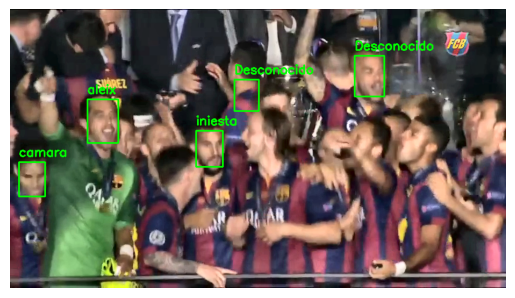

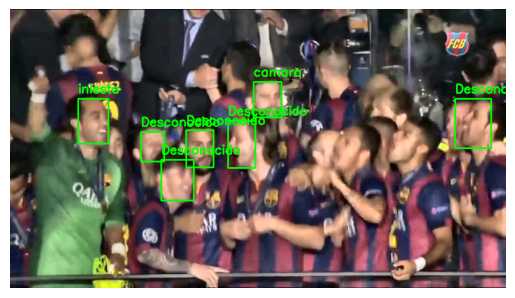

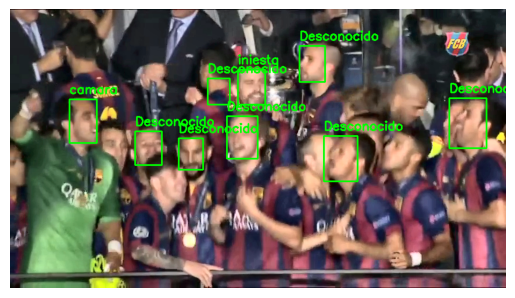

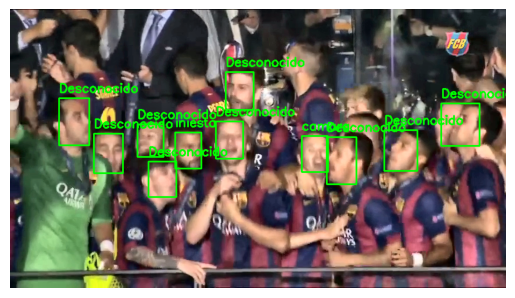

KeyboardInterrupt: 

In [ ]:
from deepface import DeepFace
import os
import cv2
from matplotlib import pyplot as plt
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Función para calcular el promedio de embeddings de un jugador
def calculate_average_embedding(img_paths, model_name='Facenet'):
    embeddings = []
    for img_path in img_paths:
        embedding = DeepFace.represent(img_path=img_path, model_name=model_name)[0]['embedding']
        embeddings.append(embedding)
    return np.mean(embeddings, axis=0)

# Ruta al video
video_path = "/content/drive/My Drive/BARCELONA/barcelona.mp4"
cap = cv2.VideoCapture(video_path)

# Ruta a la carpeta de convertidas que contiene subcarpetas de jugadores
players_folder = "/content/drive/My Drive/BARCELONA/barcelona/convertidas/"

# Diccionario para almacenar el promedio de embeddings de cada jugador
player_embeddings = {}

# Recorrer todas las subcarpetas (jugadores) en la carpeta convertidas
for player in os.listdir(players_folder):
    player_folder = os.path.join(players_folder, player)
    if os.path.isdir(player_folder):  # Asegurarse de que sea una carpeta
        img_paths = [os.path.join(player_folder, img) for img in os.listdir(player_folder) if img.endswith(('.jpg', '.png'))]
        if img_paths:
            player_avg_embedding = calculate_average_embedding(img_paths)
            player_embeddings[player] = player_avg_embedding

# Variables para promediar embeddings
face_embeddings_per_frame = {}
frame_counter = 0

# Procesar el video frame por frame
while True:
    ret, frame = cap.read()  # Leer el frame del video
    if not ret:
        break  # Si no hay más frames, salir del bucle

    frame_counter += 1

    # Preprocesar el frame para mejorar contraste y nitidez
    lab = cv2.cvtColor(frame, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    cl = clahe.apply(l)
    limg = cv2.merge((cl, a, b))
    frame = cv2.cvtColor(limg, cv2.COLOR_LAB2BGR)

    # Detectar los rostros en el frame usando mtcnn
    faces_detected = DeepFace.extract_faces(img_path=frame, detector_backend='mtcnn')

    # Para cada rostro detectado en el frame
    for idx, face_obj in enumerate(faces_detected):
        # Extraer las coordenadas del área facial
        x, y, w, h = (face_obj['facial_area']['x'],
                      face_obj['facial_area']['y'],
                      face_obj['facial_area']['w'],
                      face_obj['facial_area']['h'])

        # Recortar el rostro del frame
        face_img = frame[y:y+h, x:x+w]

        # Convertir el rostro a RGB si es necesario
        face_img_rgb = cv2.cvtColor(face_img, cv2.COLOR_BGR2RGB)

        # Calcular el embedding del rostro detectado
        face_embedding = DeepFace.represent(img_path=face_img_rgb, model_name='Facenet', enforce_detection=False)[0]['embedding']

        # Almacenar embeddings por rostro en cada frame
        if idx not in face_embeddings_per_frame:
            face_embeddings_per_frame[idx] = []

        face_embeddings_per_frame[idx].append(face_embedding)

    # Cada 10 frames, promediar los embeddings y comparar con los jugadores
    if frame_counter % 10 == 0:
        assigned_players = set()

        for idx, embeddings in face_embeddings_per_frame.items():
            # Promediar los embeddings acumulados en los últimos 10 frames
            avg_face_embedding = np.mean(embeddings, axis=0)

            best_similarity = 0
            best_player = None

            # Comparar el embedding promedio del rostro con los embeddings promedios de cada jugador
            for player, player_avg_embedding in player_embeddings.items():
                if player not in assigned_players:  # Solo comparar con jugadores no asignados
                    similarity = cosine_similarity([avg_face_embedding], [player_avg_embedding])[0][0]
                    if similarity > best_similarity:  # Encontrar la mayor similitud
                        best_similarity = similarity
                        best_player = player

            # Asignar el nombre del jugador si la similitud es mayor a 0.1
            if best_player and best_similarity > 0.3:
                assigned_players.add(best_player)  # Marcar al jugador como asignado
                player_name = best_player
            else:
                player_name = "Desconocido"

            # Verificar que el índice aún exista en faces_detected antes de dibujar
            if idx < len(faces_detected):
                x, y, w, h = faces_detected[idx]['facial_area']['x'], faces_detected[idx]['facial_area']['y'], faces_detected[idx]['facial_area']['w'], faces_detected[idx]['facial_area']['h']
                cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)

                # Colocar el nombre del jugador sobre el rectángulo
                text_x, text_y = x, y - 10
                font_scale = 0.7
                cv2.putText(frame, player_name, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, font_scale, (0, 255, 0), 2)

        # Mostrar el frame procesado con los jugadores identificados
        plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        plt.axis("off")
        plt.show()

        # Limpiar los embeddings almacenados para los siguientes 10 frames
        face_embeddings_per_frame = {}

# Liberar recursos
cap.release()
cv2.destroyAllWindows()


In [ ]:
from deepface import DeepFace
import os
import cv2
from matplotlib import pyplot as plt
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Función para calcular el promedio de embeddings de un jugador
def calculate_average_embedding(img_paths, model_name='VGG-Face'):
    embeddings = []
    for img_path in img_paths:
        embedding = DeepFace.represent(img_path=img_path, model_name=model_name)[0]['embedding']
        embeddings.append(embedding)
    return np.mean(embeddings, axis=0)

# Ruta al video
video_path = "/content/drive/My Drive/BARCELONA/barcelona.mp4"
cap = cv2.VideoCapture(video_path)

# Ruta a la carpeta de convertidas que contiene subcarpetas de jugadores
players_folder = "/content/drive/My Drive/BARCELONA/barcelona/convertidas/"

# Diccionario para almacenar el promedio de embeddings de cada jugador
player_embeddings = {}

# Recorrer todas las subcarpetas (jugadores) en la carpeta convertidas
for player in os.listdir(players_folder):
    player_folder = os.path.join(players_folder, player)
    if os.path.isdir(player_folder):  # Asegurarse de que sea una carpeta
        img_paths = [os.path.join(player_folder, img) for img in os.listdir(player_folder) if img.endswith(('.jpg', '.png'))]
        if img_paths:
            player_avg_embedding = calculate_average_embedding(img_paths)
            player_embeddings[player] = player_avg_embedding

# Variables para promediar embeddings
face_embeddings_per_frame = {}
frame_counter = 0

# Procesar el video frame por frame
while True:
    ret, frame = cap.read()  # Leer el frame del video
    if not ret:
        break  # Si no hay más frames, salir del bucle

    frame_counter += 1

    # Preprocesar el frame para mejorar contraste y nitidez
    lab = cv2.cvtColor(frame, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    cl = clahe.apply(l)
    limg = cv2.merge((cl, a, b))
    frame = cv2.cvtColor(limg, cv2.COLOR_LAB2BGR)

    # Detectar los rostros en el frame usando mtcnn
    faces_detected = DeepFace.extract_faces(img_path=frame, detector_backend='mtcnn')

    # Para cada rostro detectado en el frame
    for idx, face_obj in enumerate(faces_detected):
        # Extraer las coordenadas del área facial
        x, y, w, h = (face_obj['facial_area']['x'],
                      face_obj['facial_area']['y'],
                      face_obj['facial_area']['w'],
                      face_obj['facial_area']['h'])

        # Recortar el rostro del frame
        face_img = frame[y:y+h, x:x+w]

        # Convertir el rostro a RGB si es necesario
        face_img_rgb = cv2.cvtColor(face_img, cv2.COLOR_BGR2RGB)

        # Calcular el embedding del rostro detectado
        face_embedding = DeepFace.represent(img_path=face_img_rgb, model_name='Facenet', enforce_detection=False)[0]['embedding']

        # Almacenar embeddings por rostro en cada frame
        if idx not in face_embeddings_per_frame:
            face_embeddings_per_frame[idx] = []

        face_embeddings_per_frame[idx].append(face_embedding)

    # Cada 10 frames, promediar los embeddings y comparar con los jugadores
    if frame_counter % 20 == 0:
        assigned_players = set()

        for idx, embeddings in face_embeddings_per_frame.items():
            # Promediar los embeddings acumulados en los últimos 10 frames
            avg_face_embedding = np.mean(embeddings, axis=0)

            best_similarity = 0
            best_player = None

            # Comparar el embedding promedio del rostro con los embeddings promedios de cada jugador
            for player, player_avg_embedding in player_embeddings.items():
                if player not in assigned_players:  # Solo comparar con jugadores no asignados
                    similarity = cosine_similarity([avg_face_embedding], [player_avg_embedding])[0][0]
                    if similarity > best_similarity:  # Encontrar la mayor similitud
                        best_similarity = similarity
                        best_player = player

            # Asignar el nombre del jugador si la similitud es mayor a 0.1
            if best_player and best_similarity > 0.3:
                assigned_players.add(best_player)  # Marcar al jugador como asignado
                player_name = best_player
            else:
                player_name = "Desconocido"

            # Verificar que el índice aún exista en faces_detected antes de dibujar
            if idx < len(faces_detected):
                x, y, w, h = faces_detected[idx]['facial_area']['x'], faces_detected[idx]['facial_area']['y'], faces_detected[idx]['facial_area']['w'], faces_detected[idx]['facial_area']['h']
                cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)

                # Colocar el nombre del jugador sobre el rectángulo
                text_x, text_y = x, y - 10
                font_scale = 0.7
                cv2.putText(frame, player_name, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, font_scale, (0, 255, 0), 2)

        # Mostrar el frame procesado con los jugadores identificados
        plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        plt.axis("off")
        plt.show()

        # Limpiar los embeddings almacenados para los siguientes 10 frames
        face_embeddings_per_frame = {}

# Liberar recursos
cap.release()
cv2.destroyAllWindows()


24-10-23 00:49:04 - 🔗 vgg_face_weights.h5 will be downloaded from https://github.com/serengil/deepface_models/releases/download/v1.0/vgg_face_weights.h5 to /root/.deepface/weights/vgg_face_weights.h5...


Downloading...
From: https://github.com/serengil/deepface_models/releases/download/v1.0/vgg_face_weights.h5
To: /root/.deepface/weights/vgg_face_weights.h5
100%|██████████| 580M/580M [00:05<00:00, 109MB/s]


ValueError: Incompatible dimension for X and Y matrices: X.shape[1] == 128 while Y.shape[1] == 4096

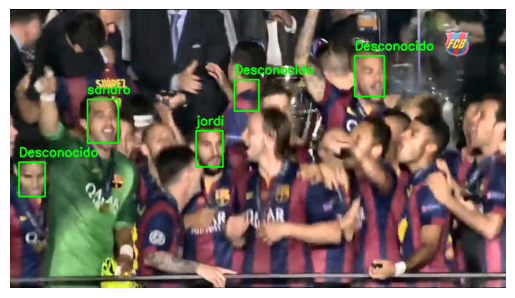

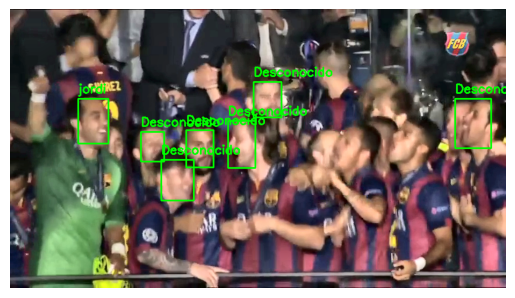

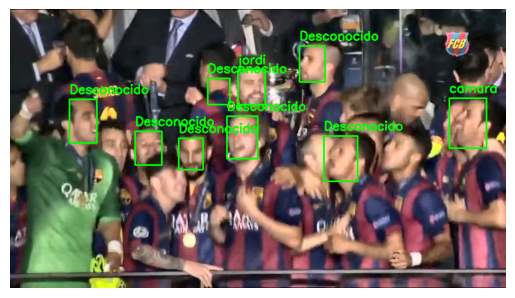

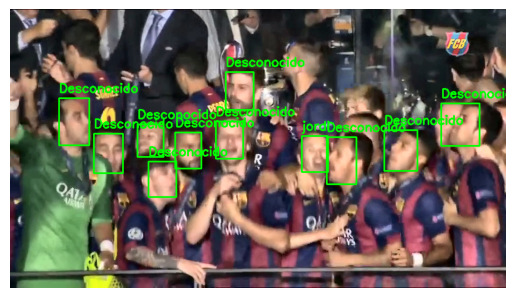

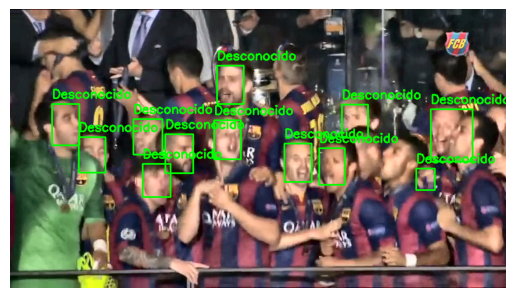

...

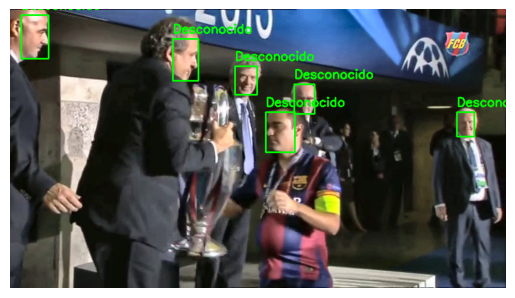

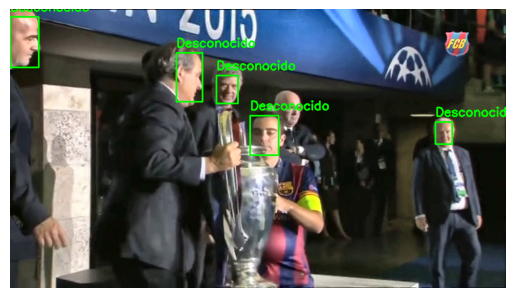

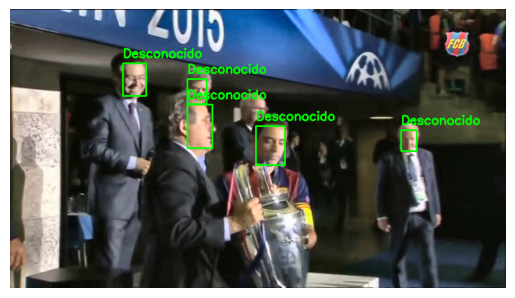

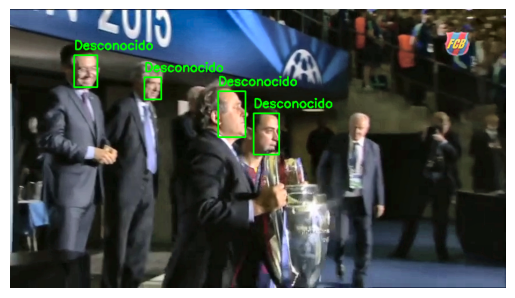

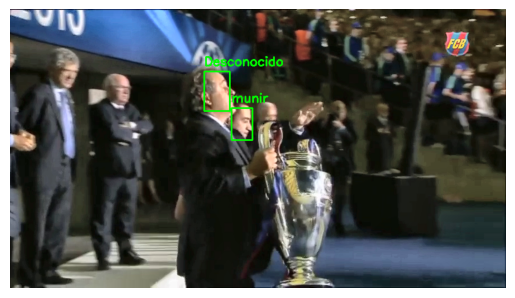

ValueError: Face could not be detected in numpy array.Please confirm that the picture is a face photo or consider to set enforce_detection param to False.

In [ ]:
from deepface import DeepFace
import os
import cv2
from matplotlib import pyplot as plt
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Función para calcular el promedio de embeddings de un jugador
def calculate_average_embedding(img_paths, model_name='VGG-Face'):  # Usando VGG-Face para todos
    embeddings = []
    for img_path in img_paths:
        embedding = DeepFace.represent(img_path=img_path, model_name=model_name)[0]['embedding']
        embeddings.append(embedding)
    return np.mean(embeddings, axis=0)

# Ruta al video
video_path = "/content/drive/My Drive/BARCELONA/barcelona.mp4"
cap = cv2.VideoCapture(video_path)

# Ruta a la carpeta de convertidas que contiene subcarpetas de jugadores
players_folder = "/content/drive/My Drive/BARCELONA/barcelona/convertidas/"

# Diccionario para almacenar el promedio de embeddings de cada jugador
player_embeddings = {}

# Recorrer todas las subcarpetas (jugadores) en la carpeta convertidas
for player in os.listdir(players_folder):
    player_folder = os.path.join(players_folder, player)
    if os.path.isdir(player_folder):  # Asegurarse de que sea una carpeta
        img_paths = [os.path.join(player_folder, img) for img in os.listdir(player_folder) if img.endswith(('.jpg', '.png'))]
        if img_paths:
            player_avg_embedding = calculate_average_embedding(img_paths, model_name='VGG-Face')  # Usamos VGG-Face
            player_embeddings[player] = player_avg_embedding

# Variables para promediar embeddings
face_embeddings_per_frame = {}
frame_counter = 0

# Procesar el video frame por frame
while True:
    ret, frame = cap.read()  # Leer el frame del video
    if not ret:
        break  # Si no hay más frames, salir del bucle

    frame_counter += 1

    # Preprocesar el frame para mejorar contraste y nitidez
    lab = cv2.cvtColor(frame, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    cl = clahe.apply(l)
    limg = cv2.merge((cl, a, b))
    frame = cv2.cvtColor(limg, cv2.COLOR_LAB2BGR)

    # Detectar los rostros en el frame usando mtcnn
    faces_detected = DeepFace.extract_faces(img_path=frame, detector_backend='mtcnn')

    # Para cada rostro detectado en el frame
    for idx, face_obj in enumerate(faces_detected):
        # Extraer las coordenadas del área facial
        x, y, w, h = (face_obj['facial_area']['x'],
                      face_obj['facial_area']['y'],
                      face_obj['facial_area']['w'],
                      face_obj['facial_area']['h'])

        # Recortar el rostro del frame
        face_img = frame[y:y+h, x:x+w]

        # Convertir el rostro a RGB si es necesario
        face_img_rgb = cv2.cvtColor(face_img, cv2.COLOR_BGR2RGB)

        # Calcular el embedding del rostro detectado con VGG-Face
        face_embedding = DeepFace.represent(img_path=face_img_rgb, model_name='VGG-Face', enforce_detection=False)[0]['embedding']

        # Almacenar embeddings por rostro en cada frame
        if idx not in face_embeddings_per_frame:
            face_embeddings_per_frame[idx] = []

        face_embeddings_per_frame[idx].append(face_embedding)

    # Cada 10 frames, promediar los embeddings y comparar con los jugadores
    if frame_counter % 10 == 0:
        assigned_players = set()

        for idx, embeddings in face_embeddings_per_frame.items():
            # Promediar los embeddings acumulados en los últimos 10 frames
            avg_face_embedding = np.mean(embeddings, axis=0)

            best_similarity = 0
            best_player = None

            # Comparar el embedding promedio del rostro con los embeddings promedios de cada jugador
            for player, player_avg_embedding in player_embeddings.items():
                if player not in assigned_players:  # Solo comparar con jugadores no asignados
                    similarity = cosine_similarity([avg_face_embedding], [player_avg_embedding])[0][0]
                    if similarity > best_similarity:  # Encontrar la mayor similitud
                        best_similarity = similarity
                        best_player = player

            # Asignar el nombre del jugador si la similitud es mayor a 0.3
            if best_player and best_similarity > 0.3:
                assigned_players.add(best_player)  # Marcar al jugador como asignado
                player_name = best_player
            else:
                player_name = "Desconocido"

            # Verificar que el índice aún exista en faces_detected antes de dibujar
            if idx < len(faces_detected):
                x, y, w, h = faces_detected[idx]['facial_area']['x'], faces_detected[idx]['facial_area']['y'], faces_detected[idx]['facial_area']['w'], faces_detected[idx]['facial_area']['h']
                cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)

                # Colocar el nombre del jugador sobre el rectángulo
                text_x, text_y = x, y - 10
                font_scale = 0.7
                cv2.putText(frame, player_name, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, font_scale, (0, 255, 0), 2)

        # Mostrar el frame procesado con los jugadores identificados
        plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        plt.axis("off")
        plt.show()

        # Limpiar los embeddings almacenados para los siguientes 10 frames
        face_embeddings_per_frame = {}

# Liberar recursos
cap.release()
cv2.destroyAllWindows()
